In [1]:
import geopandas as gpd
import libpysal
import folium
import matplotlib
from matplotlib import pyplot as plt
from libpysal import weights
import contextily as ctx

In [2]:
import warnings

warnings.filterwarnings("ignore")

In [3]:
gdf_poly = gpd.read_file('Poznan_neighbourhoods.gpkg', driver='GPKG')

In [4]:
gdf_poly.explore()

In [5]:
gdf_poly

,name,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry
0,Stary Luboń,1.0,45.766590,45.766590,0.000000,45.766590,45.766590,"MULTIPOLYGON (((629533.218 5801350.167, 629703..."
1,Świerczewo,6.0,42.784810,54.798182,12.013372,51.804142,53.032412,"MULTIPOLYGON (((629327.149 5803125.05, 629345...."
2,Strzeszyn,11.0,42.307692,70.000000,27.692308,52.450384,50.000000,"MULTIPOLYGON (((625336.374 5811965.289, 625316..."
3,Sołacz,8.0,39.285714,74.468085,35.182371,56.540657,53.458647,"MULTIPOLYGON (((630434.503 5808968.166, 630431..."
4,Umultowo,6.0,41.666667,71.428571,29.761905,53.826821,48.888889,"MULTIPOLYGON (((631160.166 5814246.49, 631161...."
5,Nowe Winogrady Wschód,5.0,42.553191,63.333333,20.780142,49.619178,47.708333,"MULTIPOLYGON (((631783.501 5811178.278, 631792..."
6,Warszawskie-Pomet-Maltańskie,11.0,38.888889,69.459518,30.570629,56.957221,61.111111,"MULTIPOLYGON (((633684.049 5809158.643, 633695..."
7,Główna,17.0,45.945946,78.378378,32.432432,57.896237,55.288462,"MULTIPOLYGON (((633693.358 5809730.525, 633519..."
8,Wilda,80.0,37.656904,82.978723,45.321820,54.617081,53.079167,"MULTIPOLYGON (((631890.01 5807139.152, 631914...."
9,Szczepankowo-Spławie-Krzesinki,1.0,39.393939,39.393939,0.000000,39.393939,39.393939,"MULTIPOLYGON (((637662.564 5800186.214, 637707..."


In [6]:
gdf_poly=gdf_poly[gdf_poly.ppm_count >2]

In [7]:
mx_queen = weights.contiguity.Queen.from_dataframe(gdf_poly)

In [8]:
mx_queen.transform = 'R'

In [9]:
gdf_poly['spatial_lag'] = weights.lag_spatial(mx_queen, gdf_poly["ppm_mean"])


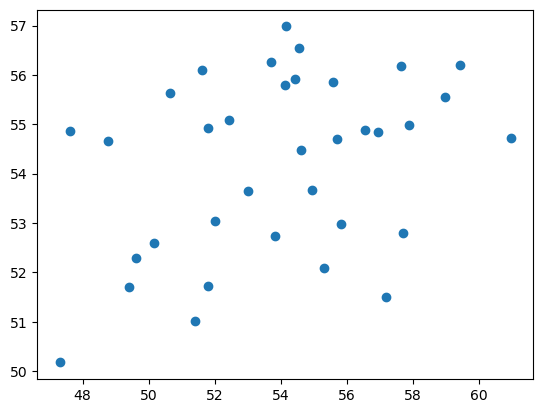

In [10]:
plt.scatter(gdf_poly['ppm_mean'],gdf_poly['spatial_lag'])

In [11]:
gdf_poly

,name,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry,spatial_lag
1,Świerczewo,6.0,42.784810,54.798182,12.013372,51.804142,53.032412,"MULTIPOLYGON (((629327.149 5803125.05, 629345....",51.727763
2,Strzeszyn,11.0,42.307692,70.000000,27.692308,52.450384,50.000000,"MULTIPOLYGON (((625336.374 5811965.289, 625316...",55.077646
3,Sołacz,8.0,39.285714,74.468085,35.182371,56.540657,53.458647,"MULTIPOLYGON (((630434.503 5808968.166, 630431...",54.888221
4,Umultowo,6.0,41.666667,71.428571,29.761905,53.826821,48.888889,"MULTIPOLYGON (((631160.166 5814246.49, 631161....",52.738777
5,Nowe Winogrady Wschód,5.0,42.553191,63.333333,20.780142,49.619178,47.708333,"MULTIPOLYGON (((631783.501 5811178.278, 631792...",52.281737
6,Warszawskie-Pomet-Maltańskie,11.0,38.888889,69.459518,30.570629,56.957221,61.111111,"MULTIPOLYGON (((633684.049 5809158.643, 633695...",54.853695
7,Główna,17.0,45.945946,78.378378,32.432432,57.896237,55.288462,"MULTIPOLYGON (((633693.358 5809730.525, 633519...",54.977132
8,Wilda,80.0,37.656904,82.978723,45.321820,54.617081,53.079167,"MULTIPOLYGON (((631890.01 5807139.152, 631914....",54.481575
10,Zielony Dębiec,10.0,38.461538,66.666667,28.205128,47.625282,46.543277,"MULTIPOLYGON (((629176.858 5802307.236, 629203...",54.864470
11,Junikowo,32.0,38.392857,67.500000,29.107143,54.164966,54.506112,"MULTIPOLYGON (((624300.882 5804621.451, 624672...",56.982835


In [12]:
gdf_poly[['ppm_mean','spatial_lag']].corr('spearman')

,ppm_mean,spatial_lag
ppm_mean,1.000000,0.290476
spatial_lag,0.290476,1.000000


In [13]:
from esda.moran  import Moran

In [14]:
moran = Moran(gdf_poly['ppm_mean'], mx_queen)

print(moran.I)

0.18547908619939069


Проверим статистическую значимость с помощью Pseudo-p-value

In [15]:
from esda.moran  import Moran

In [16]:
moran = Moran(gdf_poly['ppm_mean'], mx_queen, permutations=1000)

In [17]:
print(moran.EI_sim, moran.VI_sim,  moran.z_sim)

-0.02537015077071716 0.010486323930472385 2.0590192128854774


In [18]:
print(moran.p_sim)

0.03196803196803197


Local Moran

In [19]:
from esda.moran  import Moran_Local
moran_loc = Moran_Local(gdf_poly['ppm_mean'], mx_queen, permutations = 3000)

In [20]:
print ('Для {} районов получили выбросы'.format(sum(moran_loc.p_sim<0.01)))

Для 0 районов получили выбросы


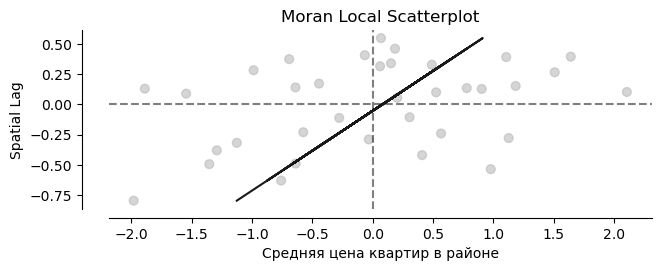

In [21]:
from splot.esda import moran_scatterplot

fig, ax = moran_scatterplot(moran_loc, p=0.01)
ax.set_xlabel('Средняя цена квартир в районе')
ax.set_ylabel('Spatial Lag')
plt.show()

In [22]:
    gdf_poly['LM_Is'] = moran_loc.Is
    gdf_poly['LM_q'] = moran_loc.q
    gdf_poly['LM_psim'] = moran_loc.p_sim
    gdf_poly['LM_esim'] = moran_loc.EI_sim

In [23]:
from splot.esda import lisa_cluster

In [24]:
gdf_poly[gdf_poly['ppm_mean'] == max(gdf_poly['ppm_mean'])]

,name,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry,spatial_lag,LM_Is,LM_q,LM_psim,LM_esim
17,Ławica,48.0,43.40836,75.365049,31.956689,60.975785,61.538462,"MULTIPOLYGON (((625248.425 5810036.76, 625245....",54.725185,0.482528,1,0.22026,-0.103508


In [25]:
gdf_poly[gdf_poly['ppm_median'] == max(gdf_poly['ppm_median'])]

,name,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry,spatial_lag,LM_Is,LM_q,LM_psim,LM_esim
13,Ogrody,12.0,40.384615,70.0,29.615385,59.422032,62.619048,"MULTIPOLYGON (((627509.896 5809808.352, 627501...",56.205929,1.082483,1,0.011663,-0.063845


In [26]:
gdf_poly.sort_values(by=['ppm_mean'])

,name,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry,spatial_lag,LM_Is,LM_q,LM_psim,LM_esim
42,Piątkowo Północ,4.0,43.548387,53.980000,10.431613,47.317365,45.870536,"MULTIPOLYGON (((629099.427 5814432.178, 629083...",50.173114,2.167324,3,0.137954,-0.136367
10,Zielony Dębiec,10.0,38.461538,66.666667,28.205128,47.625282,46.543277,"MULTIPOLYGON (((629176.858 5802307.236, 629203...",54.864470,-0.509166,2,0.305898,-0.102533
21,Żegrze,9.0,41.666667,61.224490,19.557823,48.769548,47.430830,"MULTIPOLYGON (((633117.031 5804690.495, 633183...",54.654730,-0.322582,2,0.388204,-0.080406
27,Nowe Winogrady Północ,11.0,39.583333,57.142857,17.559524,49.411626,51.562500,"MULTIPOLYGON (((630525.261 5811267.95, 630527....",51.702420,0.879654,3,0.048317,-0.061424
5,Nowe Winogrady Wschód,5.0,42.553191,63.333333,20.780142,49.619178,47.708333,"MULTIPOLYGON (((631783.501 5811178.278, 631792...",52.281737,0.621725,3,0.125292,-0.050100
28,Piątkowo,56.0,36.538462,82.475000,45.936538,50.173114,47.087104,"MULTIPOLYGON (((629879.557 5812054.214, 629862...",52.596171,0.439017,3,0.133955,-0.039277
23,Ostrów Tumski-Śródka-Zawady-Komandoria,4.0,42.456836,55.102041,12.645205,50.637604,52.495770,"MULTIPOLYGON (((632615.494 5807850.848, 632549...",55.636781,-0.487819,2,0.104299,-0.035580
33,Nowe Winogrady Południe,34.0,38.000000,78.125000,40.125000,51.401345,49.444444,"MULTIPOLYGON (((631820.199 5810651.748, 631834...",51.013591,0.644827,3,0.033989,-0.012270
20,Krzyżowniki-Smochowice,4.0,45.454545,64.102564,18.648019,51.623971,48.469388,"MULTIPOLYGON (((625248.425 5810036.76, 625245....",56.102507,-0.435693,2,0.095968,-0.016623
22,Chartowo,27.0,37.735849,76.923077,39.187228,51.798096,49.504950,"MULTIPOLYGON (((634340.204 5807212.513, 634424...",54.915826,-0.182104,2,0.300566,-0.014959


In [27]:
ppm_mean_coef = max(gdf_poly['ppm_mean']) / min(gdf_poly['ppm_mean'])
ppm_mean_coef

1.2886555496063654

In [28]:
ppm_median_coef = max(gdf_poly['ppm_median']) / min(gdf_poly['ppm_median'])
ppm_median_coef

1.3651257094532316

In [29]:
max(gdf_poly['ppm_mean'])

60.975785

In [30]:
import matplotlib.patheffects as pe
import matplotlib.cbook as cbook
from matplotlib_scalebar.scalebar import ScaleBar


In [31]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm


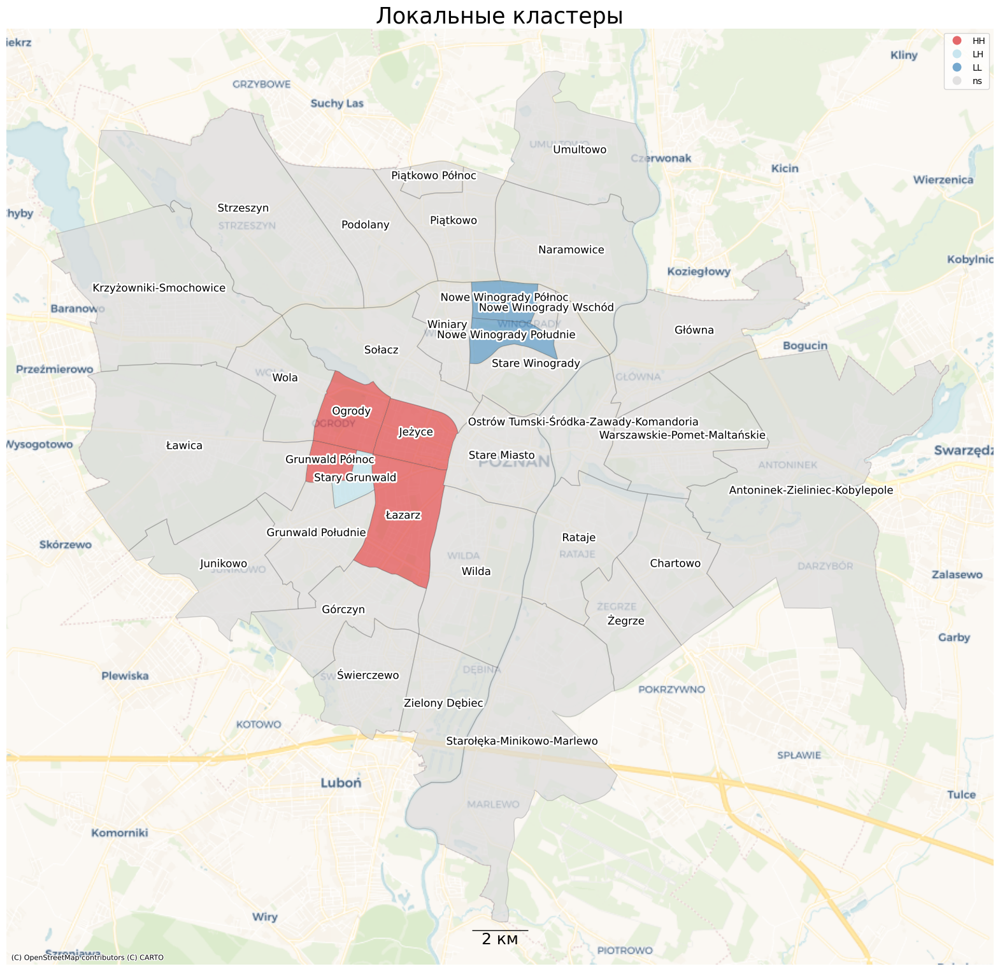

In [32]:
f, axs = plt.subplots(1,1, figsize=(20, 20))
ax = axs
lisa_cluster(moran_loc, gdf_poly.to_crs(epsg='3857'), p=0.05, figsize = (8,15), ax=ax, alpha=0.65)
gdf_poly.to_crs(epsg='3857').plot(ax=ax, legend=False, color='white', alpha=0.15, edgecolor="black", linewidth=1);
for x, y, label in zip(gdf_poly.to_crs(epsg='3857').centroid.x, gdf_poly.to_crs(epsg='3857').centroid.y, gdf_poly['name']):
    ax.annotate(label, xy=(x, y), textcoords="offset points", size=12, xytext=(0,0), ha='center', path_effects=[pe.withStroke(linewidth=4, foreground="white")])
scalebar = AnchoredSizeBar(ax.transData,
                           2000, '2 км', 'lower center', 
                           pad=1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fm.FontProperties(size=18)
)

ax.add_artist(scalebar)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_axis_off()
ax.set_title('Локальные кластеры', fontsize=25);

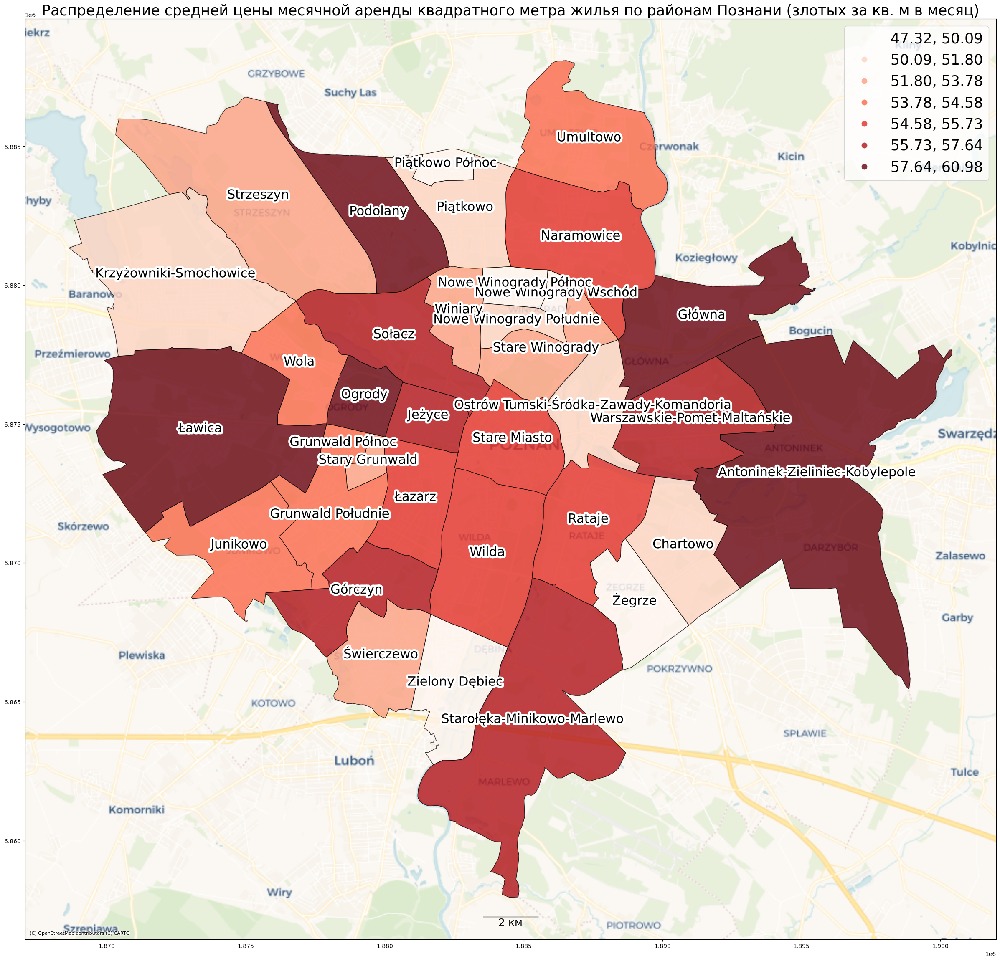

In [33]:
f, ax=plt.subplots(1,1, figsize=(30,30))

gdf_poly.to_crs(epsg='3857').plot(column="ppm_mean", ax=ax, legend=True, cmap="Reds", scheme="quantiles",
                                  k=7, alpha=0.8, edgecolor="black", linewidth=1, legend_kwds={'fontsize': 25});
for x, y, label in zip(gdf_poly.to_crs(epsg='3857').centroid.x, gdf_poly.to_crs(epsg='3857').centroid.y, gdf_poly['name']):
    ax.annotate(label, xy=(x, y), textcoords="offset points", size=22, xytext=(0,0), ha='center', path_effects=[pe.withStroke(linewidth=7, foreground="white")])
scalebar = AnchoredSizeBar(ax.transData,
                           2000, '2 км', 'lower center', 
                           pad=1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fm.FontProperties(size=18)
)

ax.add_artist(scalebar)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_title("Распределение средней цены месячной аренды квадратного метра жилья по районам Познани (злотых за кв. м в месяц)",  fontsize=25);



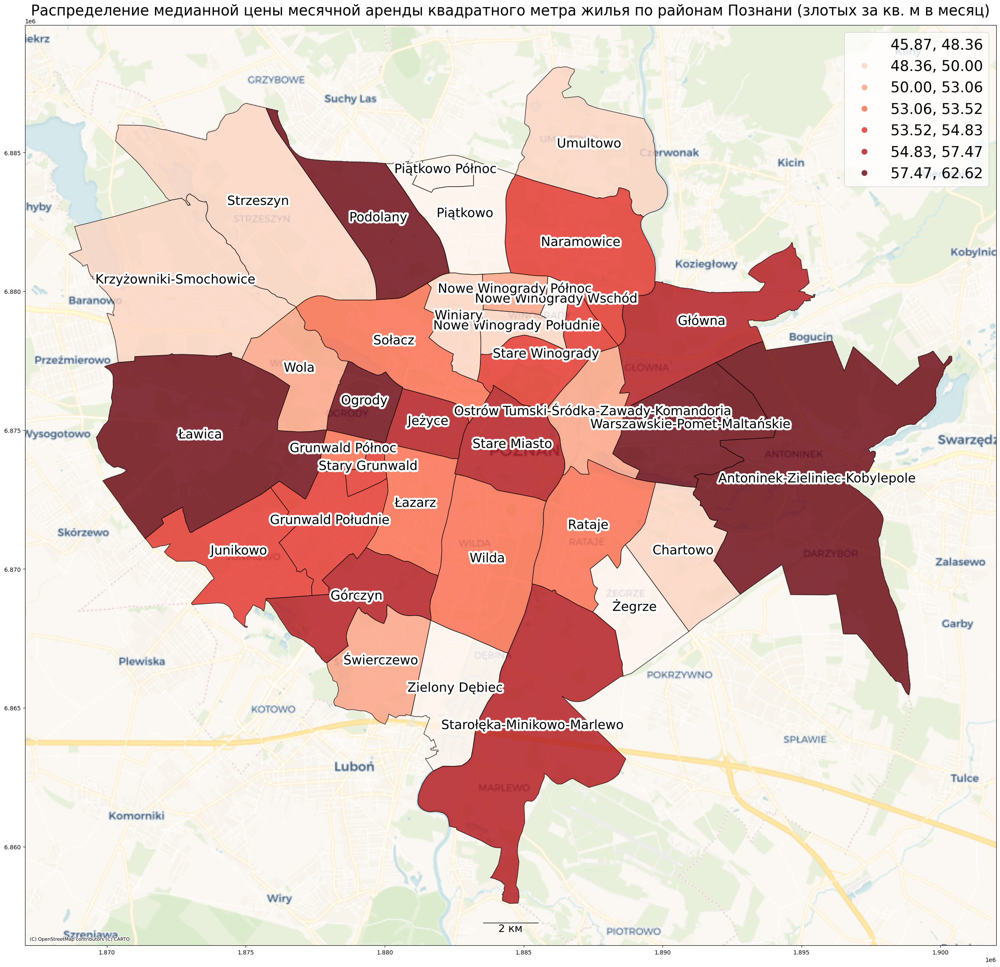

In [34]:
f, ax=plt.subplots(1,1, figsize=(30,30))

gdf_poly.to_crs(epsg='3857').plot(column="ppm_median", ax=ax, legend=True, cmap="Reds", scheme="quantiles",
                                  k=7, alpha=0.8, edgecolor="black", linewidth=1, legend_kwds={'fontsize': 25});
for x, y, label in zip(gdf_poly.to_crs(epsg='3857').centroid.x, gdf_poly.to_crs(epsg='3857').centroid.y, gdf_poly['name']):
    ax.annotate(label, xy=(x, y), textcoords="offset points", size=22, xytext=(0,0), ha='center', path_effects=[pe.withStroke(linewidth=7, foreground="white")])
scalebar = AnchoredSizeBar(ax.transData,
                           2000, '2 км', 'lower center', 
                           pad=1,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fm.FontProperties(size=18)
)

ax.add_artist(scalebar)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_title("Распределение медианной цены месячной аренды квадратного метра жилья по районам Познани (злотых за кв. м в месяц)",  fontsize=25);


# По гексагонам H3

In [35]:
gdf_hex7 = gpd.read_file('Poznan_hex7.gpkg', driver='GPKG')

In [36]:
gdf_hex7.explore()

In [37]:
gdf_hex7=gdf_hex7[gdf_hex7["ppm_count"]>3]

In [38]:
max(gdf_hex7["ppm_mean"])/min(gdf_hex7["ppm_mean"])

1.4397646493321212

In [39]:
max(gdf_hex7["ppm_median"])/min(gdf_hex7["ppm_median"])

1.5173829575757576

In [40]:
mx_queen = weights.contiguity.Queen.from_dataframe(gdf_hex7)

In [41]:
mx_queen.transform = 'R'

In [42]:
gdf_hex7['spatial_lag'] = weights.lag_spatial(mx_queen, gdf_hex7["ppm_mean"])


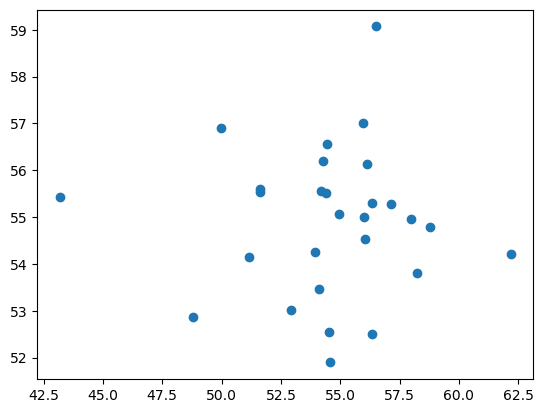

In [43]:
plt.scatter(gdf_hex7['ppm_mean'],gdf_hex7['spatial_lag'])

In [44]:
gdf_hex7

,index,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry,spatial_lag
0,871e24a14ffffff,58,39.583333,73.333333,33.750000,54.571207,53.175417,"POLYGON ((631052.805 5812938.057, 631105.641 5...",51.895503
1,871e24aa2ffffff,10,44.186047,66.666667,22.480620,56.339222,57.034632,"POLYGON ((626510.465 5804864.078, 626562.885 5...",52.503402
2,871e24ab5ffffff,7,38.000000,65.217391,27.217391,56.337801,58.695652,"POLYGON ((624081.008 5804676.562, 624133.208 5...",55.302275
3,871e24b8cffffff,5,48.780488,58.139535,9.359047,53.927459,53.488372,"POLYGON ((624903.532 5814392.032, 624955.809 5...",54.261330
4,871e24a13ffffff,9,38.888889,69.459518,30.570629,55.951405,55.592617,"POLYGON ((633640.626 5809277.309, 633693.696 5...",57.019493
5,871e24b8dffffff,13,43.382353,65.000000,21.617647,52.911869,51.162791,"POLYGON ((627331.416 5814579.801, 627383.915 5...",53.024426
7,871e24b8affffff,17,40.816327,71.428571,30.612245,54.443202,52.766471,"POLYGON ((625060.376 5810544.899, 625112.666 5...",56.555458
8,871e24a1effffff,4,51.111111,67.567568,16.456456,56.509863,53.680387,"POLYGON ((636070.093 5809464.992, 636123.384 5...",59.069759
9,871e24b88ffffff,14,39.473684,80.434783,40.961098,58.248149,59.570640,"POLYGON ((626196.036 5812562.582, 626248.43 58...",53.807018
10,871e24a16ffffff,51,37.142857,78.125000,40.982143,51.628239,48.888889,"POLYGON ((629917.64 5810920.258, 629970.372 58...",55.609524


In [45]:
gdf_hex7[['ppm_mean','spatial_lag']].corr('spearman')

,ppm_mean,spatial_lag
ppm_mean,1.000000,-0.073344
spatial_lag,-0.073344,1.000000


In [46]:
from esda.moran  import Moran

In [47]:
moran = Moran(gdf_hex7['ppm_mean'], mx_queen)

print(moran.I)

-0.0034964726976946378


Нужно еще доказать, что корелляция не случайна в силу природы данных! 




Для этого нужно проверить **"статистическую значимость"** получившихся результатов

In [48]:
from esda.moran  import Moran

In [49]:
moran = Moran(gdf_hex7['ppm_mean'], mx_queen, permutations=1000)

In [50]:
print(moran.EI_sim, moran.VI_sim,  moran.z_sim)

-0.041578337807128815 0.01216692056271279 0.3452453787575395


In [51]:
threshold = 0.05
print( moran.p_sim)

0.34465534465534464


Local Moran

In [52]:
from esda.moran  import Moran_Local
moran_loc = Moran_Local(gdf_hex7['ppm_mean'], mx_queen, permutations = 3000)

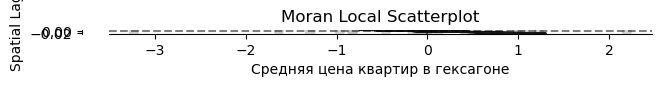

In [53]:
from splot.esda import moran_scatterplot

#moran_loc = Moran_Local(gdf_ezor_sng_utm['sng_cnt'], w_knn)

fig, ax = moran_scatterplot(moran_loc, p=0.01)
ax.set_xlabel('Средняя цена квартир в гексагоне')
ax.set_ylabel('Spatial Lag')
plt.show()

In [54]:
    gdf_hex7['LM_Is'] = moran_loc.Is
    gdf_hex7['LM_q'] = moran_loc.q
    gdf_hex7['LM_psim'] = moran_loc.p_sim
    gdf_hex7['LM_esim'] = moran_loc.EI_sim

In [55]:
from splot.esda import lisa_cluster

In [56]:
threshold

0.05

In [57]:
gdf_hex7[gdf_hex7['ppm_mean'] == max(gdf_hex7['ppm_mean'])]

,index,ppm_count,ppm_min,ppm_max,ppm_range,ppm_mean,ppm_median,geometry,spatial_lag,LM_Is,LM_q,LM_psim,LM_esim
27,871e24aadffffff,9,49.707602,73.399139,23.691537,62.188113,62.592047,"POLYGON ((634935.11 5807446.092, 634988.297 58...",54.208803,-0.181634,4,0.458847,-0.203077


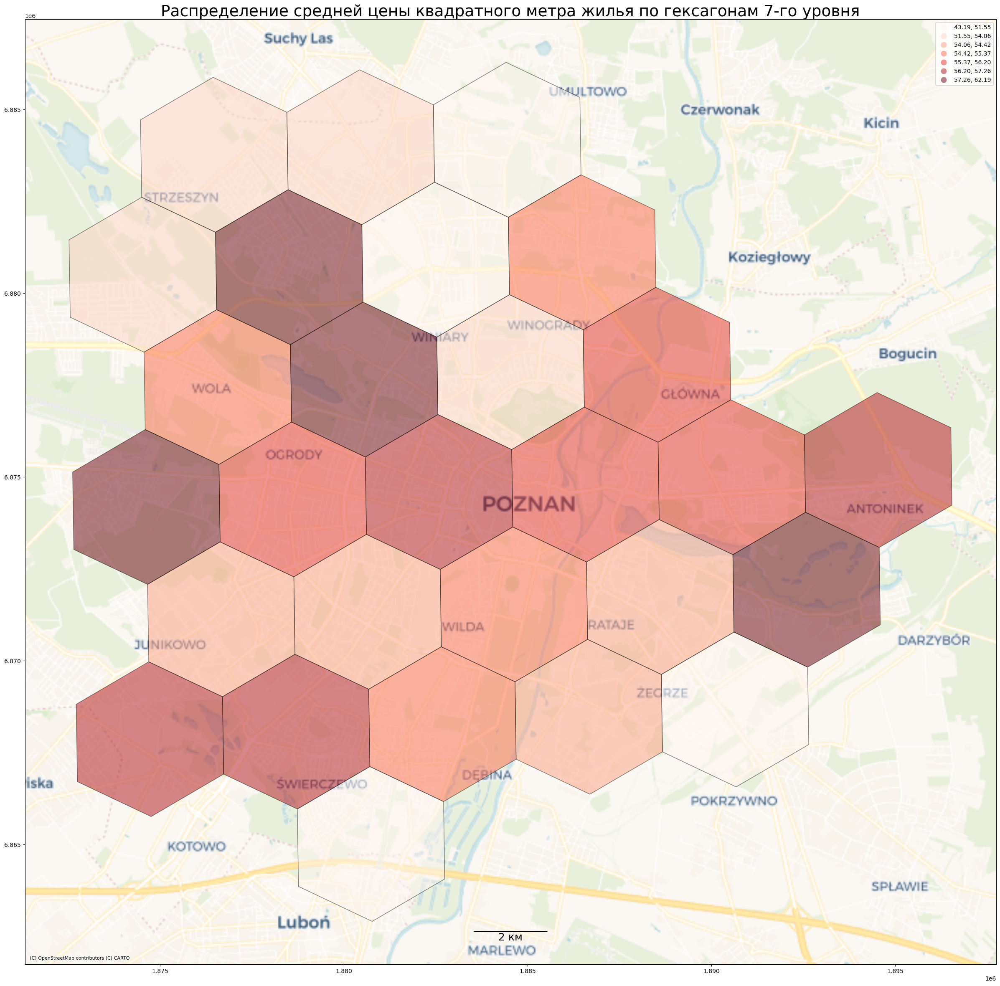

In [58]:
f, ax=plt.subplots(1,1, figsize=(30,30))

gdf_hex7.to_crs(epsg='3857').plot(column="ppm_mean", ax=ax, legend=True, cmap="Reds", 
                                  scheme="quantiles", k=7, alpha=0.5, edgecolor="black", linewidth=1);
scalebar = AnchoredSizeBar(ax.transData,
                           2000, '2 км', 'lower center', 
                           pad=2,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fm.FontProperties(size=18)
)
ax.add_artist(scalebar)

ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_title("Распределение средней цены квадратного метра жилья по гексагонам 7-го уровня",  fontsize=27);

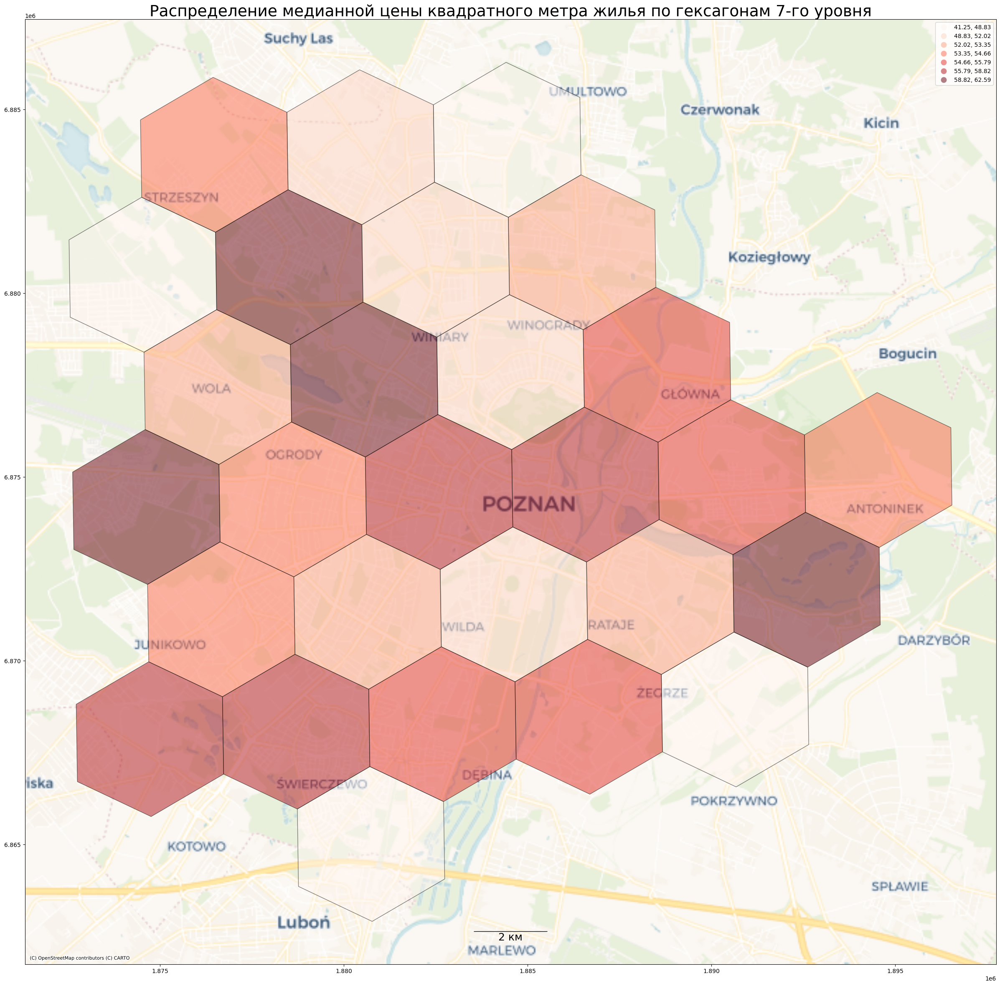

In [59]:
f, ax=plt.subplots(1,1, figsize=(30,30))

gdf_hex7.to_crs(epsg='3857').plot(column="ppm_median", ax=ax, legend=True, cmap="Reds", 
                                  scheme="quantiles", k=7, alpha=0.5, edgecolor="black", linewidth=1);
scalebar = AnchoredSizeBar(ax.transData,
                           2000, '2 км', 'lower center', 
                           pad=2,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fm.FontProperties(size=18)
)
ax.add_artist(scalebar)

ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_title("Распределение медианной цены квадратного метра жилья по гексагонам 7-го уровня",  fontsize=27);

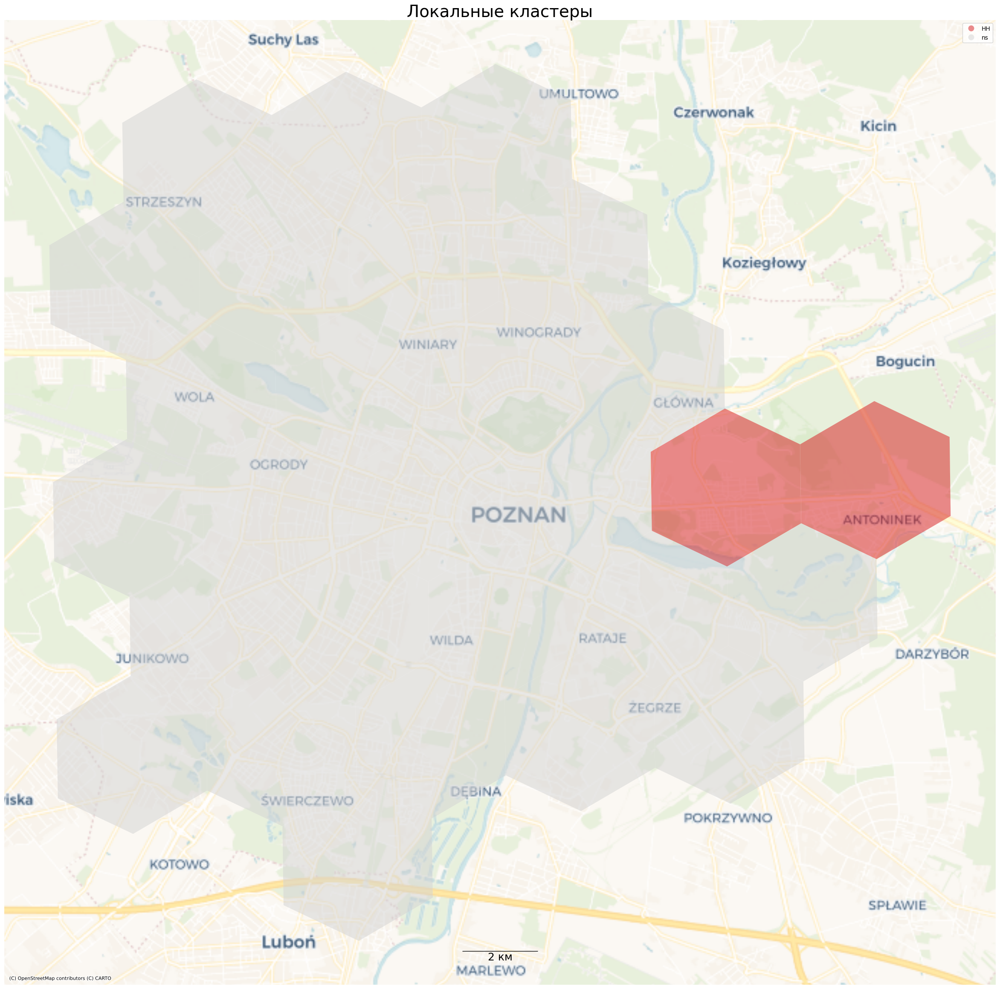

In [60]:
f, axs = plt.subplots(1,1, figsize=(30, 30))
ax = axs
lisa_cluster(moran_loc, gdf_hex7.to_crs(epsg='3857'), p=0.05, figsize = (8,15), ax=ax, alpha=0.5)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_axis_off()
scalebar = AnchoredSizeBar(ax.transData,
                           2000, '2 км', 'lower center', 
                           pad=2,
                           color='black',
                           frameon=False,
                           size_vertical=1,
                           fontproperties=fm.FontProperties(size=18)
)
ax.add_artist(scalebar)

ax.set_title('Локальные кластеры', fontsize=28);

In [61]:
ppm_mean_coef = max(gdf_hex7['ppm_mean']) / min(gdf_hex7['ppm_mean'])
ppm_mean_coef

1.4397646493321212

In [62]:
ppm_median_coef = max(gdf_hex7['ppm_median']) / min(gdf_hex7['ppm_median'])
ppm_median_coef

1.5173829575757576

In [63]:
max(gdf_hex7['ppm_mean'])

62.188113

# Считаем зависимость цены от расстояния до центра

In [64]:
gdf_new = gpd.read_file('Poznan_points.gpkg', driver='GPKG')

In [65]:
df_new = gdf_new.drop('geometry', axis=1)

In [66]:
type(df_new)

pandas.core.frame.DataFrame

In [67]:
df_new = df_new[['Price', 'Rooms', 'm2', 'ppm', 'center_distance_km']]

In [68]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df_new)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [69]:
gdf_new

,field_1,Unnamed: 0,Name,Location,Latitude,Longitude,Price,Rooms,m2,URL,ppm,center_distance_km,geometry
0,0,0,Piekne mieszkanie w samym sercu Poznania,"ul. Garbary, Stare Miasto, Stare Miasto, Pozna...",52.408363,16.938065,3300,2,54.0,https://www.otodom.pl/pl/oferta/piekne-mieszka...,61.111111,0.304,POINT (631828.763 5808226.068)
1,1,1,nowy apartament Bułgarska 59 do wynajęcia,"ul. Bułgarska 59F, Kasztelanów, Grunwald, Pozn...",52.396611,16.863290,2700,3,49.0,https://www.otodom.pl/pl/oferta/nowy-apartamen...,55.102041,4.958,POINT (626776.648 5806785.353)
2,2,2,Bez pośredników przy Głogowskiej extra od zaraz,"ul. Jakuba Krauthofera, Górczyn, Grunwald, Poz...",52.386071,16.896774,1899,1,32.0,https://www.otodom.pl/pl/oferta/bez-posredniko...,59.343750,3.517,POINT (629085.408 5805672.345)
3,3,3,Ładne mieszkanie z ogródkiem + miejsce parkingowe,"ul. Rolna, Wilda, Wilda, Poznań, wielkopolskie",52.381310,16.915711,2200,2,38.0,https://www.otodom.pl/pl/oferta/ladne-mieszkan...,57.894737,3.235,POINT (630388.063 5805176.872)
4,4,4,Ekskluzywny Apartament z basenem tuż przy parku,"os. Piastowskie 120, Rataje, Nowe Miasto, Pozn...",52.385761,16.939889,3200,2,40.0,https://www.otodom.pl/pl/oferta/ekskluzywny-ap...,80.000000,2.538,POINT (632020.259 5805715.745)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,1493,1493,"os. Przyjaźni 3 pokoje, balkon, piwnica","os. Przyjaźni, Winogrady, Stare Miasto, Poznań...",52.429946,16.922123,1950,3,48.0,https://www.otodom.pl/pl/oferta/os-przyjazni-3...,40.625000,2.538,POINT (630680.62 5810597.441)
1043,1494,1494,Lwowska 2 | Malta | 2 pokoje | garaż | od czerwca,"Łacina, Nowe Miasto, Poznań, wielkopolskie",52.395714,16.962728,2700,2,43.2,https://www.otodom.pl/pl/oferta/lwowska-2-malt...,62.500000,2.423,POINT (633544.405 5806864.554)
1044,1495,1495,Duże mieszkanie na Marcelinie,"Marcelin, Grunwald, Poznań, wielkopolskie",52.404461,16.878942,3900,3,70.0,https://www.otodom.pl/pl/oferta/duze-mieszkani...,55.714286,3.744,POINT (627818.815 5807685.953)
1045,1496,1496,"Duża kawalerka, nowe budownictwo z windą","Łazarz, Grunwald, Poznań, wielkopolskie",52.399516,16.899641,1900,1,34.0,https://www.otodom.pl/pl/oferta/duza-kawalerka...,55.882353,2.507,POINT (629241.221 5807172.794)


In [70]:
# Коэффициент корреляции Пирсона
pearson_corr = gdf_new['ppm'].corr(gdf_new['center_distance_km'])
print(f"Pearson correlation: {pearson_corr}")

# Коэффициент корреляции Спирмена
spearman_corr = gdf_new['ppm'].corr(gdf_new['center_distance_km'], method='spearman')
print(f"Spearman correlation: {spearman_corr}")

Pearson correlation: -0.07011064143785749
Spearman correlation: -0.06913107427198942


In [71]:
import statsmodels.api as sm

# Пример данных
X = gdf_new['center_distance_km']
y = gdf_new['ppm']

# Добавляем константу для линейной регрессии
X = sm.add_constant(X)

# Создание и подгонка модели
model = sm.OLS(y, X).fit()

# Результаты модели
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:                    ppm   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     5.162
Date:                Sat, 15 Mar 2025   Prob (F-statistic):             0.0233
Time:                        20:21:49   Log-Likelihood:                -3903.5
No. Observations:                1047   AIC:                             7811.
Df Residuals:                    1045   BIC:                             7821.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 56.1093      0

In [72]:
model.pvalues[1]

0.023287863311419965

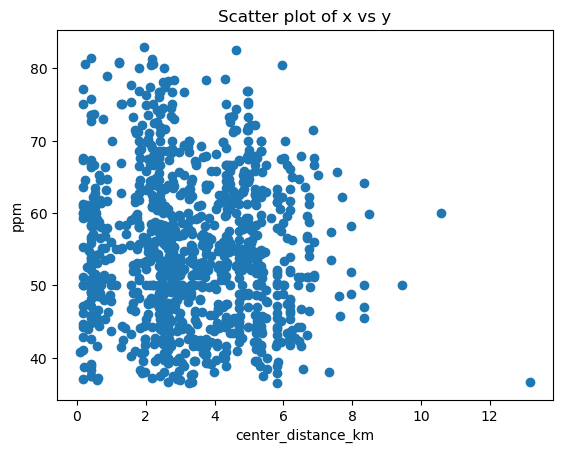

In [73]:
import matplotlib.pyplot as plt

# График рассеяния
plt.scatter(gdf_new['center_distance_km'], gdf_new['ppm'])
plt.xlabel('center_distance_km')
plt.ylabel('ppm')
plt.title('Scatter plot of x vs y')
plt.show()


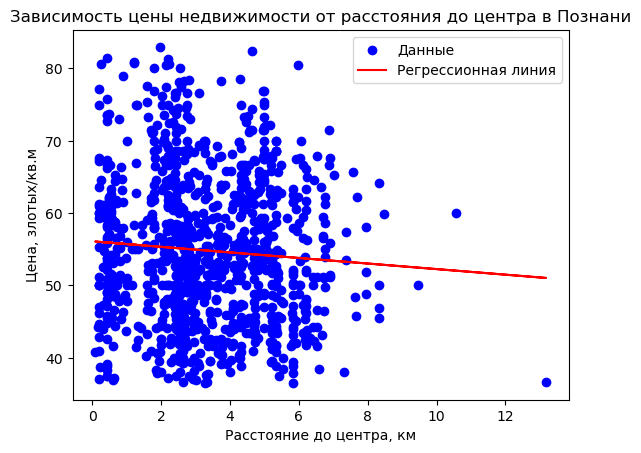

In [74]:
import matplotlib.pyplot as plt

# Исходные данные
plt.scatter(gdf_new['center_distance_km'], gdf_new['ppm'], color='blue', label='Данные')

# Регрессионная линия
plt.plot(gdf_new['center_distance_km'], model.predict(X), color='red', label='Регрессионная линия')

# Настройка графика
plt.xlabel('Расстояние до центра, км')
plt.ylabel('Цена, злотых/кв.м')
plt.legend()
plt.title('Зависимость цены недвижимости от расстояния до центра в Познани')
plt.show()
